 # 1. Business Context

Employee turn-over is a very costly problem for companies. The cost of replacing an employee if often larger than 100K USD, taking into account the time spent to interview and find a replacement, placement fees, sign-on bonuses and the loss of productivity for several months.

As a business, we want to take proactive actions by analyzing the historical employees churning data. Why do they leave? When do they leave? Once we have these insights, how can we incorporate them to our people strategies?

# 2. Technical Solutions

Let's look at the data we have on hand and how we can translate the business problem into a technical one.

## 2.1 Data Overview

We got employee data from a few companies. We have data about all employees who joined from 2011/01/24 to 2015/12/13. For each employee, we also know if they are still at the company as of 2015/12/13 or they have quit. Beside that, we have general info about the employee, such as avg salary during her tenure, dept, and yrs of experience.

Recently I finished a Tableau course, so for this challenge I'm gonna use Tableau for EDA to test my understandings. If the table below is not working, please go to this link for an interactive visualization.
https://public.tableau.com/views/employee_retention_Book1/Dashboard1?:display_count=y&publish=yes&:origin=viz_share_link

In [99]:
%%HTML
<div>
<div class='tableauPlaceholder' id='viz1580669907716' style='position: relative'><noscript><a href='#'><img alt=' ' src='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;em&#47;employee_retention_Book1&#47;Dashboard1&#47;1_rss.png' style='border: none' /></a></noscript><object class='tableauViz'  style='display:none;'><param name='host_url' value='https%3A%2F%2Fpublic.tableau.com%2F' /> <param name='embed_code_version' value='3' /> <param name='site_root' value='' /><param name='name' value='employee_retention_Book1&#47;Dashboard1' /><param name='tabs' value='no' /><param name='toolbar' value='yes' /><param name='static_image' value='https:&#47;&#47;public.tableau.com&#47;static&#47;images&#47;em&#47;employee_retention_Book1&#47;Dashboard1&#47;1.png' /> <param name='animate_transition' value='yes' /><param name='display_static_image' value='yes' /><param name='display_spinner' value='yes' /><param name='display_overlay' value='yes' /><param name='display_count' value='yes' /><param name='filter' value='publish=yes' /></object></div>                <script type='text/javascript'>                    var divElement = document.getElementById('viz1580669907716');                    var vizElement = divElement.getElementsByTagName('object')[0];                    vizElement.style.width='1000px';vizElement.style.height='827px';                    var scriptElement = document.createElement('script');                    scriptElement.src = 'https://public.tableau.com/javascripts/api/viz_v1.js';                    vizElement.parentNode.insertBefore(scriptElement, vizElement);                </script>
</div>

In the tableau visualization, I broke down the population by Company, Department, Seniority and Salary. Some insights:

1. The size of the company, and the size of the department vary. Company 1 has the most employees. Company 7 has the largest churn rate. Department wise, Customer Service has the most employees. Sales has the largest churn rate.

2. On average, people who left worked for about 20 months. In Company 11 and 12 the average duration is significantly shorter. Department wise, sales is the shortest.

3. Seniority alone doesn't affect quit or not, or the duration.

4. People who quit has a lower range in Salary. There is also a mildly negative correlation between correlation  and duration. Most people left before 20 months across different companies or department.

However, nothing causal can be concluded from this visualization because there are many variants - more analysis is needed to surface the underlying patterns.

## 2.2 headcount by company by day
Assume, for each company, that the headcount starts from zero on 2011/01/23. Estimate employee headcount, for each company, on each day, from 2011/01/24 to 2015/12/13. That is, if by 2012/03/02 2000 people have joined company 1 and 1000 of them have already quit, then company headcount on 2012/03/02 for company 1 would be 1000. 

In [119]:
import pandas as pd
from datetime import date
from datetime import timedelta
import matplotlib.pyplot as plt
import numpy as np

In [3]:
df = pd.read_csv("employee_retention_data.csv")

In [38]:
df.head()

,employee_id,company_id,dept,seniority,salary,join_date,quit_date
0,13021.0,7,customer_service,28,89000.0,2014-03-24,2015-10-30
1,825355.0,7,marketing,20,183000.0,2013-04-29,2014-04-04
2,927315.0,4,marketing,14,101000.0,2014-10-13,NaT
3,662910.0,7,customer_service,20,115000.0,2012-05-14,2013-06-07
4,256971.0,2,data_science,23,276000.0,2011-10-17,2014-08-22


In [19]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 24702 entries, 0 to 24701
Data columns (total 7 columns):
employee_id    24702 non-null float64
company_id     24702 non-null int64
dept           24702 non-null object
seniority      24702 non-null int64
salary         24702 non-null float64
join_date      24702 non-null datetime64[ns]
quit_date      13510 non-null datetime64[ns]
dtypes: datetime64[ns](2), float64(2), int64(2), object(1)
memory usage: 1.3+ MB


In [16]:
df['join_date'] = pd.to_datetime(df['join_date'])

In [18]:
df['quit_date'] = pd.to_datetime(df['quit_date'])

In [70]:
i_date = pd.datetime(2011,1,24)
date = []
company_id = []
headcount = []

while i_date != pd.datetime(2015,12,14):
    for cid in range(1,13):
        join_count = len(df[(df['company_id']==cid) & (df['join_date']<=i_date)])
        quit_count = len(df[(df['company_id']==cid) & (df['quit_date']<=i_date)])
        hc = join_count - quit_count
        date.append(i_date)
        company_id.append(cid)
        headcount.append(hc)
        
    i_date = i_date + timedelta(1)
    
df_headcount = pd.DataFrame({'date':date,'company_id':company_id,'headcount':headcount})


In [83]:
df_headcount.head()

,date,company_id,headcount
0,2011-01-24,1,25
1,2011-01-24,2,17
2,2011-01-24,3,9
3,2011-01-24,4,12
4,2011-01-24,5,5


<Figure size 720x720 with 0 Axes>

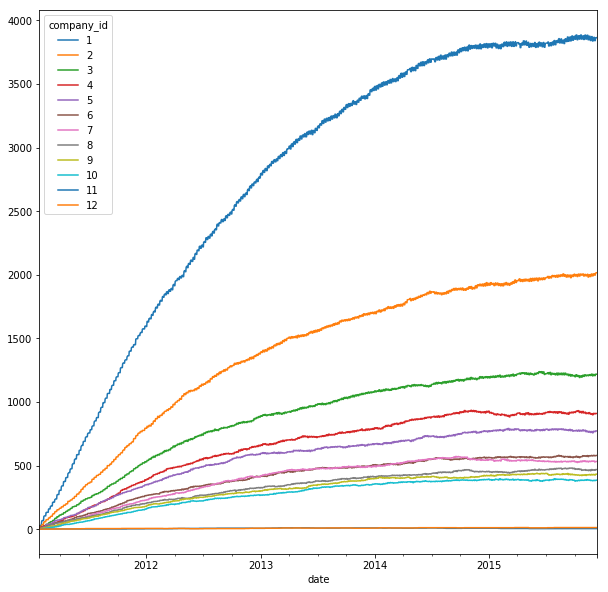

In [101]:
plt.figure(figsize=(10,10))
df_headcount.pivot_table(index = 'date', columns = 'company_id', values = 'headcount').plot(figsize=(10,10))


In this chart, we see Company 1 is definitely dominating in headcounts. Most companies hire more in the beginning, but the increase slows down. Company 11 and 12 didn't grow much in headcounts throughout 4 years.

## 2.3 Churn factor analysis

What are the main factors that drive employee churn? Do they make sense? 

One concern of fitting a model directly using the entire dataset and compare people who quit vs people who didn't is censoring. This means we need to consider 2 issues: 1) there are people who will not churn. 2) there are people who will churn given enough time but are not yet captured as "quit" in our dataset. We can estimate a Weibull-Gamma model with changing hazard rate for each company - each employee has a probability of churning at any given time. This will give us a more accurate forecast on when each employees will churn, if they haven't in our dataset. 

However, for the purpose of analyzing factors, we can assume the dataset covers enough combinations of different scenarios to be treated with a classification model. After all, we are not interested in a perfectly accurate model with the exact weights of each features but on the direction and relative impact.

### 2.3.1 pre-processing

In [122]:
df_new = df[df['seniority']<40]
print ('Removed', len(df)-len(df_new), 'outliers')
quit = []
def check_quit(x):
    if pd.isnull(x):
        quit.append(0)
    else:
        quit.append(1)
df_new['quit_date'].apply(lambda x: check_quit(x))
df_new['quit'] = quit
df_new['duration'] = ((df['quit_date']-df['join_date'])/np.timedelta64(1, 'M')).round(0)
# df_new['duration'] = df_new['duration'].apply(lambda x: x.months)

Removed 2 outliers


/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # Remove the CWD from sys.path while we load stuff.
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  # This is added back by InteractiveShellApp.init_path()


In [124]:
df_new.head()

,employee_id,company_id,dept,seniority,salary,join_date,quit_date,quit,duration
0,13021.0,7,customer_service,28,89000.0,2014-03-24,2015-10-30,1,19.0
1,825355.0,7,marketing,20,183000.0,2013-04-29,2014-04-04,1,11.0
2,927315.0,4,marketing,14,101000.0,2014-10-13,NaT,0,NaN
3,662910.0,7,customer_service,20,115000.0,2012-05-14,2013-06-07,1,13.0
4,256971.0,2,data_science,23,276000.0,2011-10-17,2014-08-22,1,34.0


### 2.3.2 machine learning 

In [138]:
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import MinMaxScaler
from sklearn.linear_model import LogisticRegressionCV
from sklearn.tree import DecisionTreeClassifier

from sklearn.metrics import precision_score, recall_score, accuracy_score

In [131]:
df_ml = df_new[['company_id','dept','seniority','salary','quit']]
df_ml['company_id']= df_ml['company_id'].astype('category')
df_ml['dept'] = df_ml['dept'].astype('category')
df_ml = pd.get_dummies(df_ml)



/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:3: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  This is separate from the ipykernel package so we can avoid doing imports until


In [135]:
# prepare train, test and scale the data
y = df_ml['quit']
X = df_ml.drop('quit', axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X,y)

In [136]:
scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)


In [137]:
logreg = LogisticRegressionCV()
logreg.fit(X_train_scaled, y_train)
y_pred = logreg.predict(X_test_scaled)
print ("accuracy: ", accuracy_score(y_test,y_pred))
print ("precision: ", precision_score(y_test,y_pred))
print ("recall: ", recall_score(y_test,y_pred))

/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


accuracy:  0.5438056680161943
precision:  0.5483583154889364
recall:  0.914855611789223


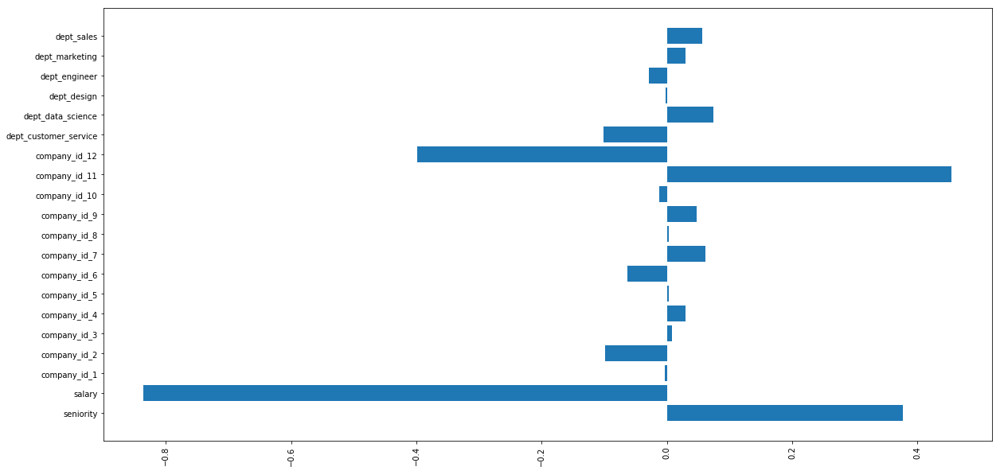

In [154]:
coef = logreg.coef_[0]
plt.figure(figsize=(20,10))
plt.barh(y=X.columns,width = coef)
plt.xticks(rotation = 90)
plt.show()

The accuracy is not good but the recall is high. This means the model was able to find people who actually left 91% of the time, but the accuracy and precision suffer probably because of the concerns we mentioned above - The model finds people who are about to quit but are labeled as 0 in the provided dataset. 

To test this, let's add another creterion to our labeling. Previously we take people who had a null quit_date as 0 in the quit column. Now we want to filter out people who were hired recently - less than 14 months after they were hired - from the 0 class. 14-months is the median duration for people who left the company. By excluding the recent hires, we can assume people who didn't quit had the opportunity to quit but decided not to.

We assume that the last update of this dataset is 12/10/2015, which is the max date value in it.

In [183]:
df_test = df_new[['company_id','dept','seniority','salary','quit','join_date']]
df_test = df_test[df_test['join_date']<pd.datetime(2015,12,10)-timedelta(14*30)]
print('Removed', round((len(df_new)-len(df_test))/len(df_new)*100,2), '% of the sample (recent hires)')

Removed 23.4 % of the sample (recent hires)


/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)
/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


accuracy:  0.6976744186046512
precision:  0.6976744186046512
recall:  1.0


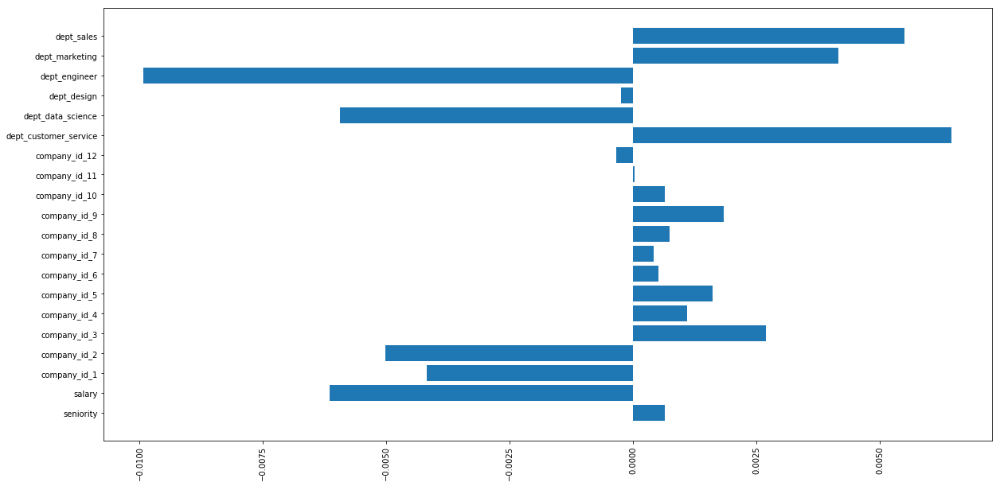

In [184]:
df_test = df_test.drop('join_date',axis = 1)
df_test['company_id']= df_test['company_id'].astype('category')
df_test['dept'] = df_test['dept'].astype('category')
df_test = pd.get_dummies(df_test)
# prepare train, test and scale the data
y = df_test['quit']
X = df_test.drop('quit', axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X,y)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

logreg = LogisticRegressionCV()
logreg.fit(X_train_scaled, y_train)
y_pred = logreg.predict(X_test_scaled)
print ("accuracy: ", accuracy_score(y_test,y_pred))
print ("precision: ", precision_score(y_test,y_pred))
print ("recall: ", recall_score(y_test,y_pred))

coef = logreg.coef_[0]
plt.figure(figsize=(20,10))
plt.barh(y=X.columns,width = coef)
plt.xticks(rotation = 90)
plt.show()

The performance is a lot better - especially the recall rate. This proves our hypothesis earlier, but there is a better way to account for the recent hires without losing 23.4% of the data - created a new binary variable for all records indicating whether all not they were hired 14 months before 12/10/2015. 

/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy
  
/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)
/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


accuracy:  0.7577327935222672
precision:  0.7009680134680135
recall:  0.9779800352319437


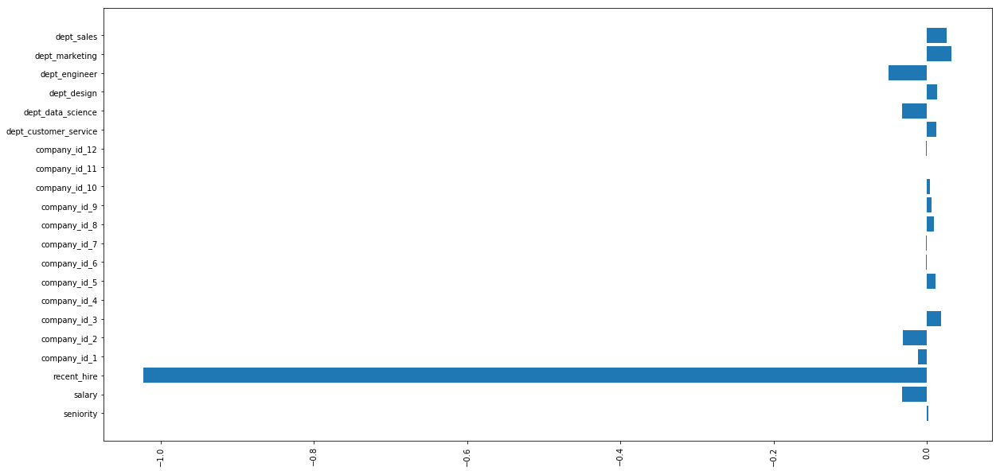

In [225]:
df_test = df_new[['company_id','dept','seniority','salary','quit','join_date']]
df_test['recent_hire'] = np.where(df_test['join_date']<pd.datetime(2015,12,10)-timedelta(14*30),0,1)

df_test = df_test.drop('join_date',axis = 1)
df_test['company_id']= df_test['company_id'].astype('category')
df_test['dept'] = df_test['dept'].astype('category')
df_test = pd.get_dummies(df_test)
# prepare train, test and scale the data
y = df_test['quit']
X = df_test.drop('quit', axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X,y)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

logreg = LogisticRegressionCV()
logreg.fit(X_train_scaled, y_train)
y_pred = logreg.predict(X_test_scaled)
print ("accuracy: ", accuracy_score(y_test,y_pred))
print ("precision: ", precision_score(y_test,y_pred))
print ("recall: ", recall_score(y_test,y_pred))

coef = logreg.coef_[0]
plt.figure(figsize=(20,10))
plt.barh(y=X.columns,width = coef)
plt.xticks(rotation = 90)
plt.show()

We get better performance this time. From the feature importance graph we can see the sign of the coefficients didn't change much across all 3 models, but whether a person was hired recently did confound our results earlier and actually helps explaining a lot more of this dataset. The coefficient of recent_hires means there were many recent hires in the training dataset need a huge offset - they were similar to those people to quit, but were labeled as not quit because they didn't have enough time. This doesn't affect our strategy, though.

For a better understanding, let's rank top 5 impactful features:

In [222]:
top_10 = np.argsort(-np.absolute(coef))[:10]
for i in top_10:
    print ("%-25s %s" % ((X.columns[i], coef[i])))

recent_hire               -1.0267952001742553
dept_engineer             -0.05761292854061408
salary                    -0.02715963625317389
dept_sales                0.026191997403712457
dept_customer_service     0.020124026029667275
dept_marketing            0.018616156755386335
dept_data_science         -0.018606848898164295
company_id_2              -0.017755842960141797
company_id_3              0.015286119550413466
dept_design               0.011306451591178544


test on people who stayed after the first 14 months

Removed 28.99 % of the sample (recent hires)


/anaconda3/lib/python3.6/site-packages/sklearn/preprocessing/data.py:323: DataConversionWarning: Data with input dtype uint8, int64, float64 were all converted to float64 by MinMaxScaler.
  return self.partial_fit(X, y)
/anaconda3/lib/python3.6/site-packages/sklearn/model_selection/_split.py:2053: FutureWarning: You should specify a value for 'cv' instead of relying on the default value. The default value will change from 3 to 5 in version 0.22.
  warnings.warn(CV_WARNING, FutureWarning)


accuracy:  0.672976054732041
precision:  0.5288107887208827
recall:  0.8215873015873015


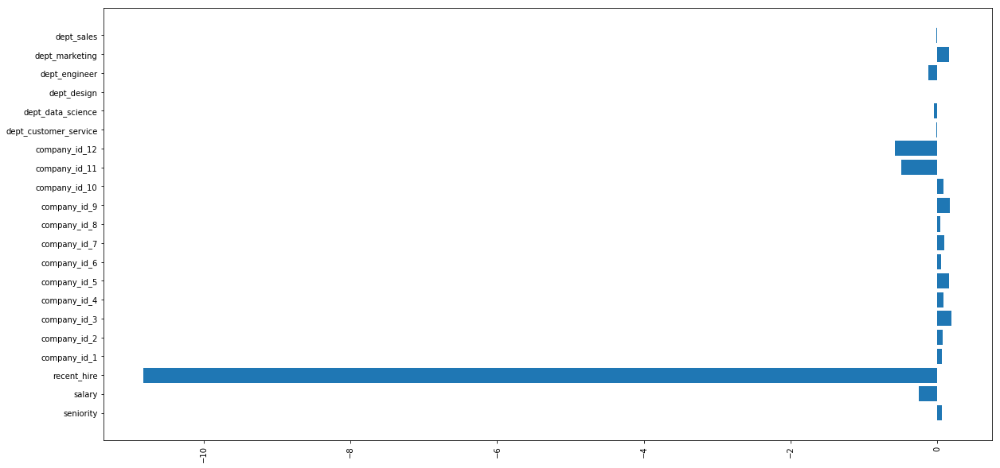

recent_hire               -10.821791064554324
company_id_12             -0.5729020867577486
company_id_11             -0.4940131222765008
salary                    -0.24645105011707924
company_id_3              0.19366589694547795
company_id_9              0.1777780014246504
dept_marketing            0.16455906400654377
company_id_5              0.15893835680566018
dept_engineer             -0.11782477741559341
company_id_7              0.09893293490296674


In [226]:
df_test = df_new[['company_id','dept','seniority','salary','quit','join_date','duration']]
df_test = df_test[(df_test['duration'].isnull()) |(df_test['duration']>14) ]
df_test['recent_hire'] = np.where(df_test['join_date']<pd.datetime(2015,12,10)-timedelta(14*30),0,1)
print('Removed', round((len(df_new)-len(df_test))/len(df_new)*100,2), '% of the sample (recent hires)')

df_test = df_test.drop(['join_date','duration'],axis = 1)
df_test['company_id']= df_test['company_id'].astype('category')
df_test['dept'] = df_test['dept'].astype('category')
df_test = pd.get_dummies(df_test)
# prepare train, test and scale the data
y = df_test['quit']
X = df_test.drop('quit', axis = 1)
X_train, X_test, y_train, y_test = train_test_split(X,y)

scaler = MinMaxScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

logreg = LogisticRegressionCV()
logreg.fit(X_train_scaled, y_train)
y_pred = logreg.predict(X_test_scaled)
print ("accuracy: ", accuracy_score(y_test,y_pred))
print ("precision: ", precision_score(y_test,y_pred))
print ("recall: ", recall_score(y_test,y_pred))

coef = logreg.coef_[0]
plt.figure(figsize=(20,10))
plt.barh(y=X.columns,width = coef)
plt.xticks(rotation = 90)
plt.show()

top_10 = np.argsort(-np.absolute(coef))[:10]
for i in top_10:
    print ("%-25s %s" % ((X.columns[i], coef[i])))

# 3. Applications and Next Steps

What are the proactive strategies we could take, knowing the patterns in the data? What If you could add to this data set just one variable that could help explain employee churn, what would that be?

Some direct interpretation from the feature importance:

1. From the visualization, we found out that there were a lot of people leaving after a bit more than a year. 

2. Engineers are less likely to leave.

3. Salary has a negative impact on quiting - the higher you earn, the less likely you'll leave. It shows in our visualization too.

4. Sales and customer service are more likely to leave - this makes sense because they tend to have high turn over rate across industry. However, if we exclude people who left in the first 14 months, these 2 teams actually had not much impact on quitting. 

5. After we exclude the first 14 months quitters, company_id becomes a more impactful feature than department. This also makes sense - CS and sales may have a impact in short term because of the nature of the job, but people quit after years probably because more of the company. Company 11 and 12 are less likely to have leaving employees (probably because they're small to begin with), Company 3, 9 and 7 are positively correlated to quitting.   

Some strategies that incorporate the interpretations:
1. create bonus structure, especially for customer service, sales, design departments.

2. design on-boarding or employees caring program knowing many leave around 14 months - we should have more events and employees interviewing in the first year to make sure employees' voices are heard.

3. Company 3, 9, 5, 7 need to collect data such as exit interviews to further investigate why people leave in the long run.


Some other factors to look into
1. employee satisfaction - can also be inferred by metrics like promotion frequency, work time etc.

2. how they were hired - staffing companies, internal referral, etc. so we can analyze the best hiring channel.

3. demographic data, gender/race are sensitive data for hiring analytics, but if we just use them to see whether a certain group tend to leave and whether we need an "inclusivity task force".



# 4. Appendix - Decision tree map

Graphviz is an useful library to visualize the decision flow that HR people can refer to. 


In [221]:
import graphviz
import sklearn.tree as tree
dtc = DecisionTreeClassifier()
dtc.fit(X_train, y_train)
y_pred = dtc.predict(X_test)
print ("accuracy: ", accuracy_score(y_test,y_pred))
print ("precision: ", precision_score(y_test,y_pred))
print ("recall: ", recall_score(y_test,y_pred))

# Visualization
features = list(X.columns)
targets = ['Not quit', 'Quit']
dot_data = tree.export_graphviz(dtc, out_file=None, feature_names=features, class_names=targets, 
                                filled=True, rounded=True, special_characters=True, )  
graph = graphviz.Source(dot_data)
graph

accuracy:  0.6432388663967611
precision:  0.679874213836478
recall:  0.6459515984463698


This is could be useful if we creat a tree for each company or department in the future - currently, we have too many categorical variables as a result of one hot encoding so the tree visualization is too broad to be interpretable.